<a href="https://colab.research.google.com/github/balakhnyov/technoatom-ML-homeworks/blob/homework1/homework5/HW.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import tqdm
import re
from lightfm import LightFM

C:\ProgramData\Anaconda3\lib\site-packages\lightfm\_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn(


In [ ]:
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds

C:\ProgramData\Anaconda3\lib\site-packages\gensim\similarities\__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


In [ ]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

# Домашнее задание

Data contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0.

### 1. Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

### 2. На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 25) - 2 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

### 3. Применить методы расмотренные на лекции (Совстречаемость - 2 балл, Content-based - 1 балл, Коллаборативная фильтрация - 3 балла , Матричная Факторизация - 1 балл) - 7 баллов

В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок

Коллаборативную фильтрацию реализовывать как на слайде 50 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл.

Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

### Примечание:

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации

Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)

Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

# Жесткий дедлайн 12 мая

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.

In [ ]:
books = pd.read_csv("HW_files\BX-Books.csv")

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [ ]:
interactions = pd.read_csv("HW_files\BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [ ]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [ ]:
interactions

,User-ID,ISBN,Book-Rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
6,276736,3257224281,8
7,276737,0600570967,6
...,...,...,...
1149773,276704,0806917695,5
1149775,276704,1563526298,9
1149777,276709,0515107662,10
1149778,276721,0590442449,10


In [ ]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [ ]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [ ]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [ ]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [ ]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [ ]:
users = pd.read_csv('HW_files\BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [ ]:
users.head()

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [ ]:
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [ ]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [ ]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [ ]:
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,3445
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,5248
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,2622
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,10887
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,4228


In [ ]:
csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

### Ищем id нужных книг

In [ ]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "Tom Gordon" in j:
        print("idx:", i, "\tBook Title:", j)

idx: 8308 	Book Title: The Girl Who Loved Tom Gordon : A Novel
idx: 7447 	Book Title: The Girl Who Loved Tom Gordon


# Data preparation

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly 
import plotly.graph_objs as go
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.express as px
from plotly.offline import iplot, init_notebook_mode
import cufflinks as cf
import plotly.figure_factory as ff 
from plotly.offline import iplot
from plotly import tools

cf.go_offline() 

init_notebook_mode(connected=False) 

plt.rcParams['figure.dpi'] = 100
colors = px.colors.qualitative.Prism
pio.templates.default = "plotly_white"

In [ ]:
interactions['Book-Rating'].iplot(kind='hist',
           fill=True)

In [ ]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278858 entries, 0 to 278857
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   User-ID   278858 non-null  int64  
 1   Location  278858 non-null  object 
 2   Age       168096 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 6.4+ MB


In [ ]:
users['Age'].iplot(kind='hist',
           fill=True)

In [ ]:
users = users[(users['Age']>12) & 
              (users['Age']<85)]

In [ ]:
users.head()

,User-ID,Location,Age
1,2,"stockton, california, usa",18.0
3,4,"porto, v.n.gaia, portugal",17.0
5,6,"santa monica, california, usa",61.0
9,10,"albacete, wisconsin, spain",26.0
10,11,"melbourne, victoria, australia",14.0


In [ ]:
users[users['User-ID']==66483]

,User-ID,Location,Age
66482,66483,"berlin, berlin, germany",16.0


# Персональный топ

In [ ]:
class UserTop:
    def __init__(self, Users, Int):
        self.users = Users
        self.product_id_to_url = {}

        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]

        self.interactions = Int.merge(Users, on=["User-ID"])

    def get_top(self, age, location):
        recs = self.interactions.loc[(self.interactions["Location"] == location) | (self.interactions["Age"] == age)] .groupby("product_id")["vid"].count() \
        .reset_index().sort_values("vid", ascending=False)[:10]

        rec_imaging(recs["product_id"].values, self.product_id_to_url,
                    recs["vid"].values)

In [ ]:
pers_top = UserTop(users, interactions)

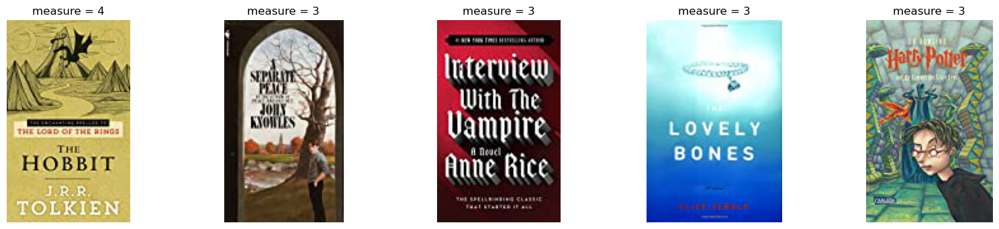

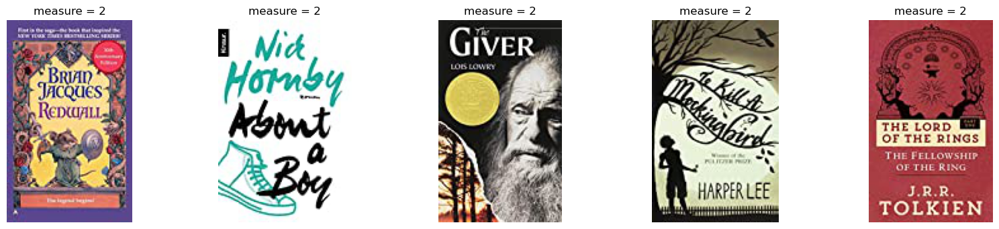

In [ ]:
pers_top.get_top(16.0, 'berlin, berlin, germany')

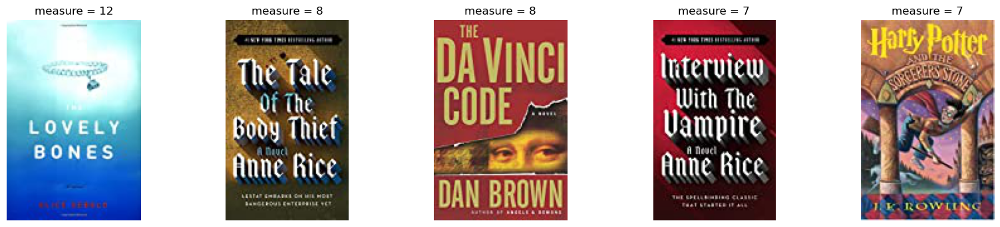

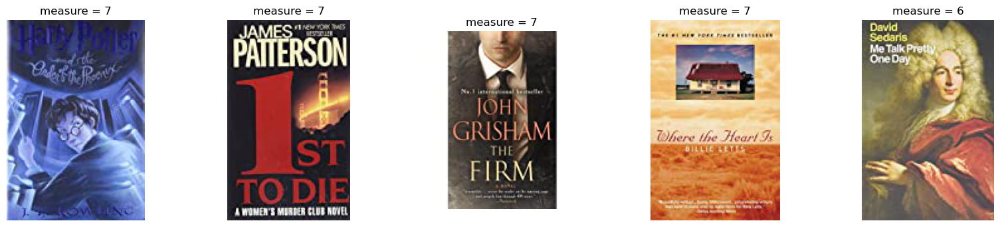

In [ ]:
pers_top.get_top(30.0, 'moscow, moscow, russia')

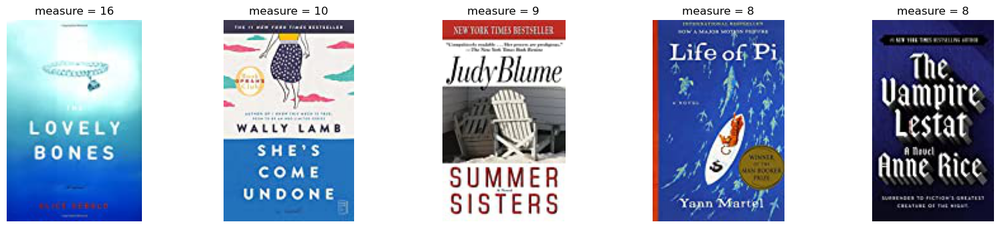

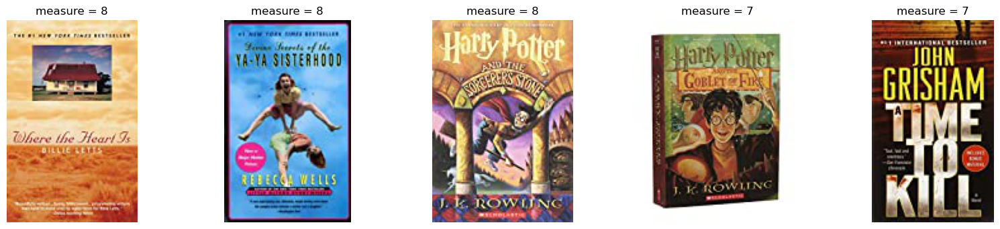

In [ ]:
pers_top.get_top(25.0, 'london, london, united kingdom')

# Кластеризация

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
class Clustering:
    def __init__(self, Int):
        self.interactions = Int
        self.vid = Int["vid"].unique()
        
        csr_rates = coo_matrix((Int["Book-Rating"], (Int["vid"], Int["product_id"])), 
                            shape=(len(set(Int["vid"])), len(set(Int["product_id"]))))
        metrics = []
        for idx in self.vid:
            user_rates = csr_rates.getrow(idx).toarray()[0]
            watched_items = np.where(user_rates != 0)[0]
            metric = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)
            metrics.append(np.sqrt(np.sum((metric - metric.mean())**2))/metric.shape[0])
        metrics = np.array(metrics).reshape(-1, 1)
        kmeans = KMeans(n_clusters=20, random_state=42).fit(metrics)

        self.clusters = kmeans.labels_

    def get_recs(self, idx):
        try:
            user_vid = self.interactions['vid'][np.where(self.interactions['User-ID'] == idx)[0][0]]
        except:
            print('Wrong User-ID')
            return
        
        cluster_id = self.clusters[list(self.vid).index(user_vid)]
        uni_idx = self.vid[np.where(self.clusters == cluster_id)[0]]
        Int = pd.DataFrame([], columns=self.interactions.columns)

        j = 0
        for i in range(self.interactions.shape[0]):
            if self.interactions.loc[i]['vid'] in uni_idx:
                Int.loc[j] = self.interactions.loc[i].values
                j += 1
        
        Int['Book-Rating'] = np.array(Int['Book-Rating'], dtype=np.float64)
        Int = pd.DataFrame(Int.groupby('ISBN')['Book-Rating'].mean().reset_index()).merge(self.interactions[['ISBN', 'picture_url']].drop_duplicates(), on='ISBN')
        Int = Int.sort_values(by='Book-Rating', ascending=False, ignore_index=True)
        self.print_recs(Int, 10)
        
    def print_recs(self, Int, n_top):
        for i in range(n_top):
            if i%5 == 0:
                fig = plt.figure(figsize=(20, 4))
            r = requests.get(Int.loc[i]['picture_url'])
            im = Image.open(BytesIO(r.content))

            a = fig.add_subplot(1, 5, int(i%5) + 1)
            a.title.set_text("Mean rating = {}".format(np.round(Int.loc[i]['Book-Rating'], 2)))
            plt.imshow(im)
            plt.axis('off')

In [ ]:
clst = Clustering(interactions)

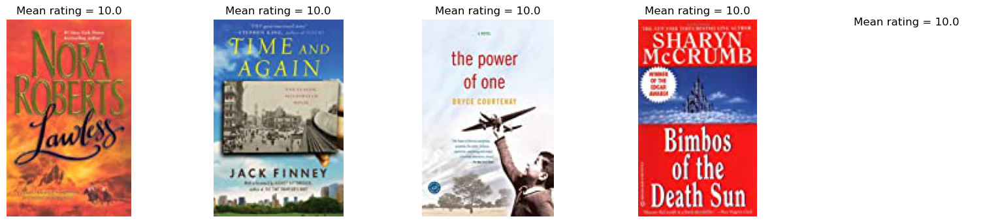

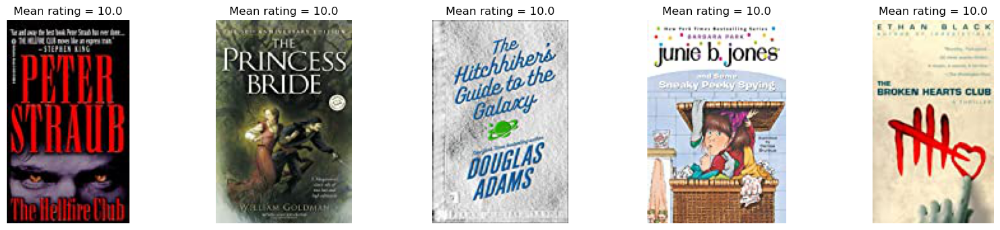

In [ ]:
clst.get_recs(66483)

ID брать из тех, что есть в interactions

In [ ]:
interactions

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,3445
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,5248
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,2622
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,10887
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,4228
...,...,...,...,...,...,...,...,...,...
110514,27551,0849912970,10,6,6,http://images.amazon.com/images/P/0849912970.0...,Traveling Light: Releasing the Burdens You Wer...,9478,1035
110515,206652,1860465811,9,8,10,http://images.amazon.com/images/P/1860465811.0...,Wind-Up Bird Chronicle,10209,8112
110516,223525,1588720284,8,6,13,http://images.amazon.com/images/P/1588720284.0...,Why Your Life Sucks: And What You Can Do Abou...,10138,8754
110517,94153,0060652926,9,7,14,http://images.amazon.com/images/P/0060652926.0...,Mere Christianity,276,3740


# Методы, применённые на лекции

## Совстречаемость

In [ ]:
class Recomendations():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url", "Book-Rating"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id", "Book-Rating"]].drop_duplicates()
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index().merge(Int.groupby(['vid'])['Book-Rating'].apply(list), on='vid')
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        user_products = user_products[user_products["prod_num"] > 1]
        
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += (i[2][j] + i[2][k]) / 2.0
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        
        cooc_list = []
        for i, j in cooc.items():
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [ ]:
cooc_rec = Recomendations(interactions)
cooc_rec.coocurrency_count()

<ipython-input-71-3ae6bb0a9c65>:16: TqdmDeprecationWarning:

This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



Для товара


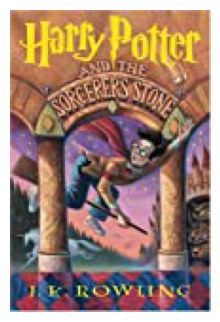

Такие рекомендации


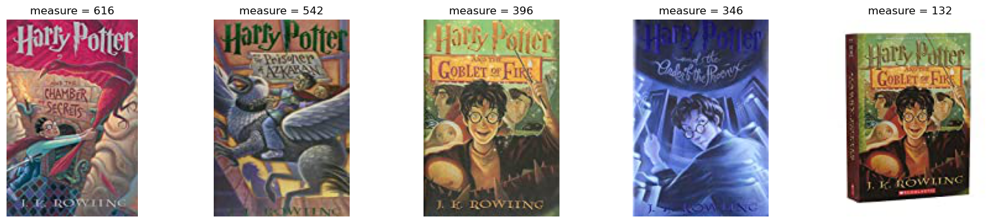

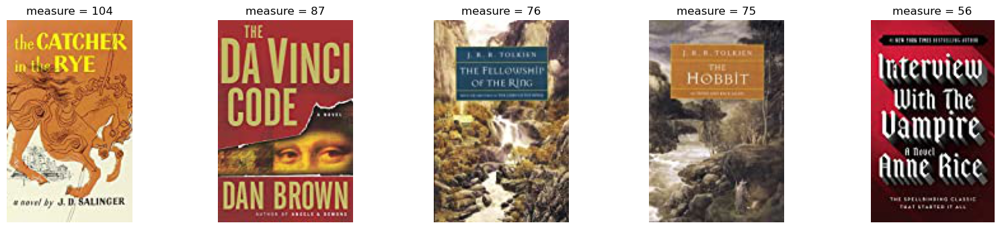

In [ ]:
cooc_rec.get_rec(7035)

Для товара


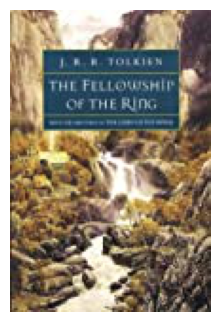

Такие рекомендации


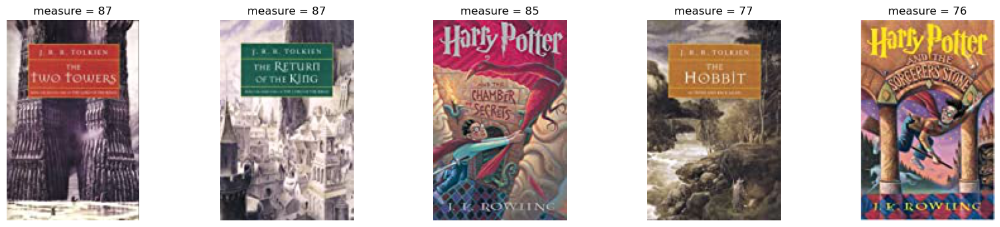

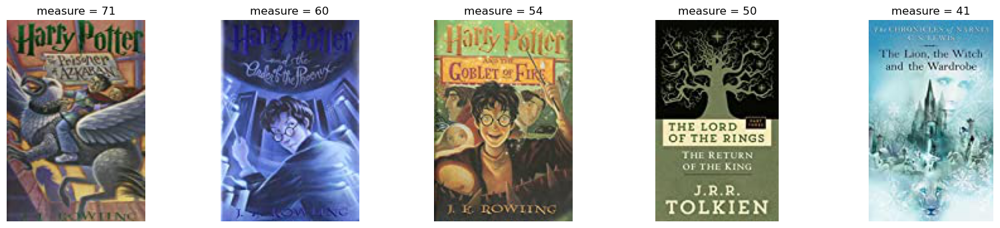

In [ ]:
cooc_rec.get_rec(7164)

Для товара


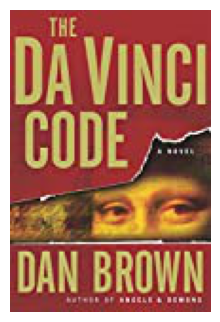

Такие рекомендации


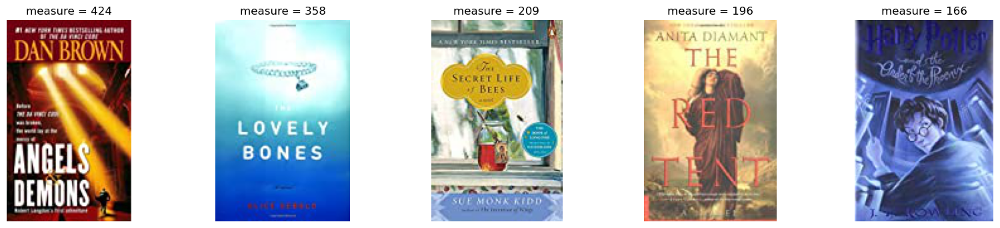

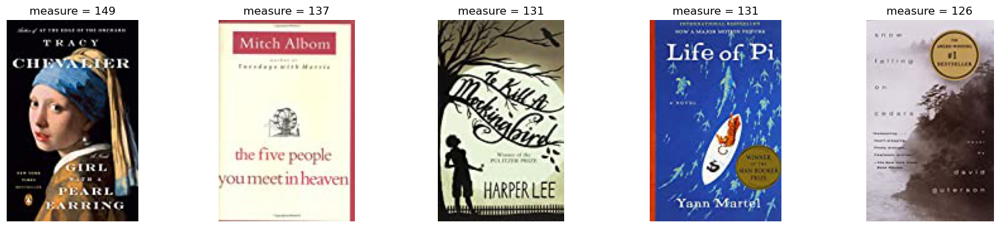

In [ ]:
cooc_rec.get_rec(3461)

## Content-Based

In [ ]:
class Content_Based():
    def __init__(self, books, interactions):
        interactions = interactions.merge(books[['ISBN', 'Book-Author', 'Year-Of-Publication', 'Publisher']].drop_duplicates(), on='ISBN')
        self.items = pd.DataFrame(interactions[['Book-Title', 'Book-Author', 'Year-Of-Publication', 'Publisher']].astype(str).sum(1), columns=['text']).drop_duplicates().reset_index().drop(columns=['index'])
        self.interactions = interactions
        self.interactions['text'] = interactions[['Book-Title', 'Book-Author', 'Year-Of-Publication', 'Publisher']].astype(str).sum(1).values
        self.content_dict = {}
        for i, j in enumerate(interactions["picture_url"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['text']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                vector_size=200,
                window=10,
                min_count=1,
                workers=10,
                epochs=100)
        self.index2word_set = set(self.model.wv.index_to_key)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [ ]:
CB = Content_Based(books, interactions)

In [ ]:
CB.get_items_representation()

Для пользователя, который взаимодействовал с товарами


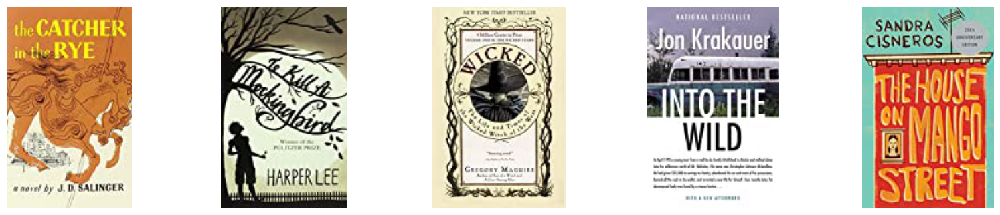

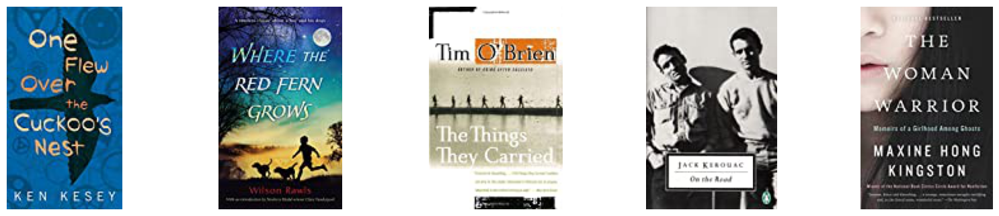

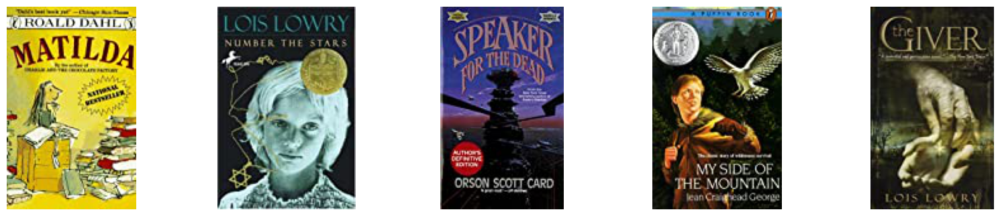

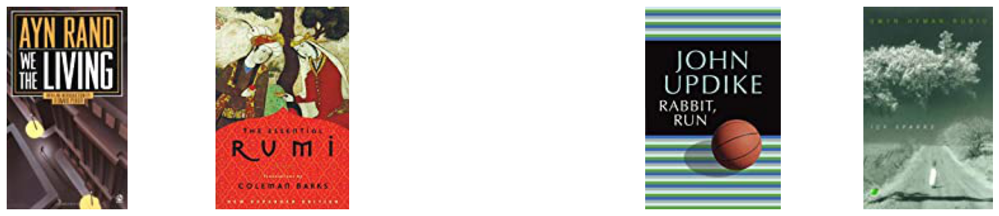

Такие рекомендации


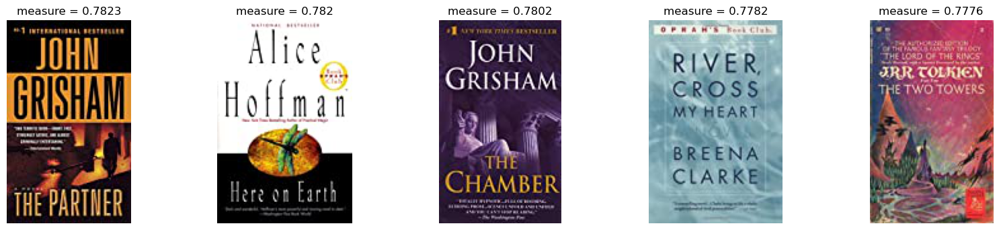

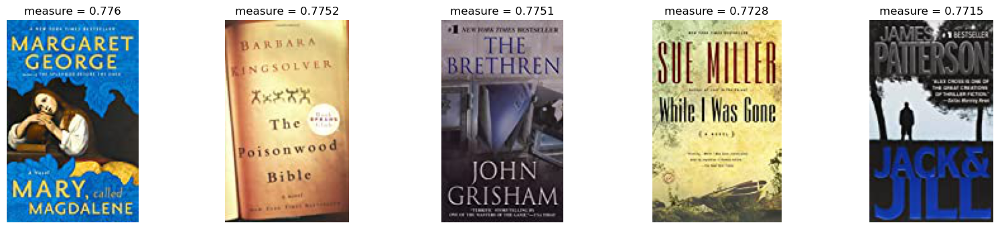

In [ ]:
CB.get_rec_U2I(258)

Для пользователя, который взаимодействовал с товарами


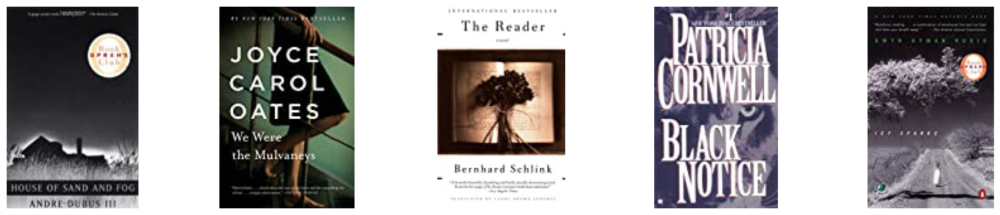

Такие рекомендации


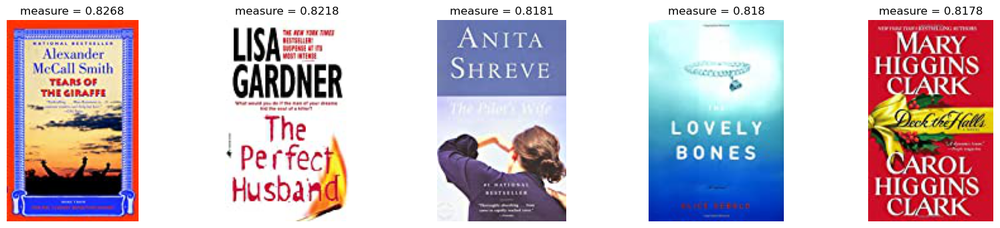

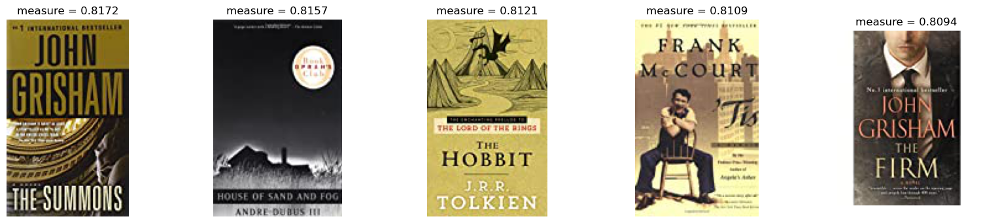

In [ ]:
CB.get_rec_U2I(1000)

Для товара


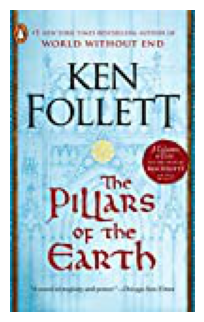

Такие рекомендации


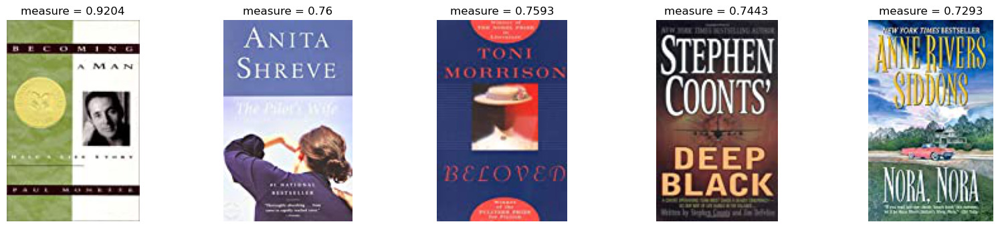

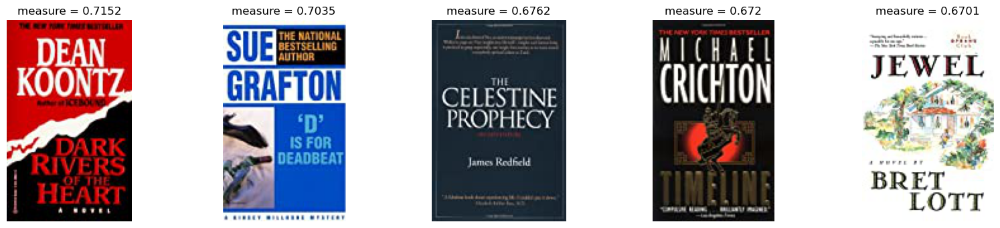

In [ ]:
CB.get_rec_I2I(900)

# Matrix Factorization

In [ ]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        weighted = interactions[['vid', 'product_id', 'picture_url', 'Book-Rating']]
        self.csr_rates = coo_matrix((weighted["Book-Rating"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))
    
    def get_rec_U2I(self, i):
        user_rates = self.csr_rates.getrow(i).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        items = user_rates[watched_items]
        metrics = cosine_similarity([self.user_embs[i]], self.user_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(items, self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [ ]:
mf = MatrixFactorization(interactions, 30)
mf.MF()

Для пользователя, который взаимодействовал с товарами


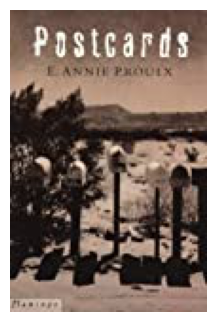

Такие рекомендации


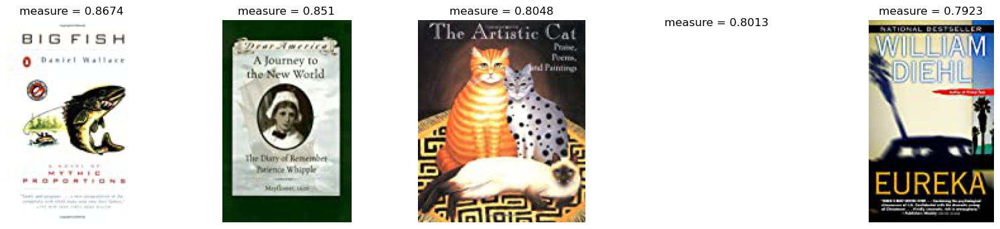

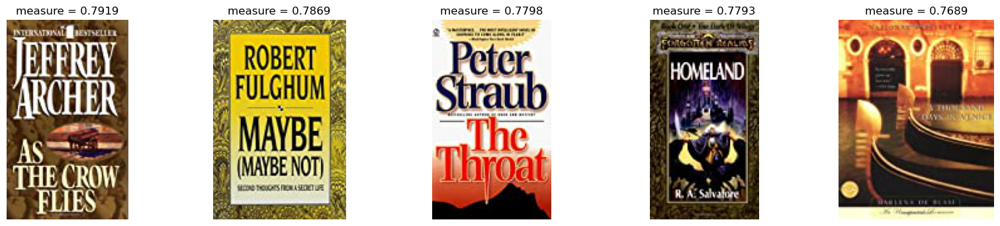

In [ ]:
mf.get_rec_U2I(558)

Для товара


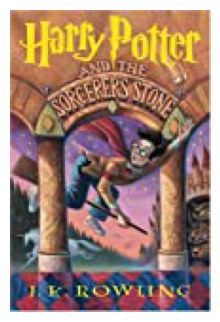

Такие рекомендации


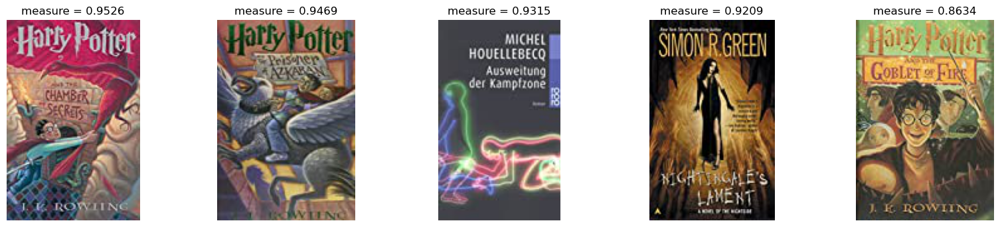

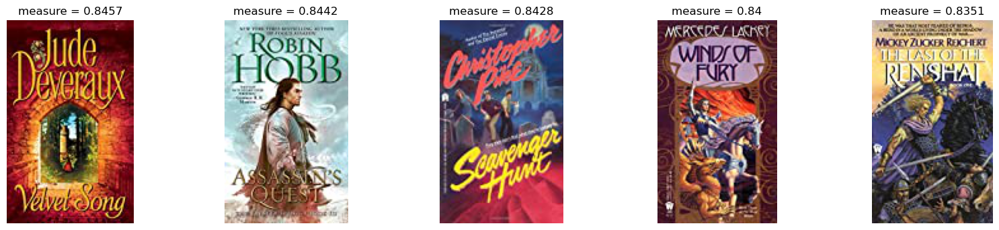

In [ ]:
mf.get_rec_I2I(7035)

Для товара


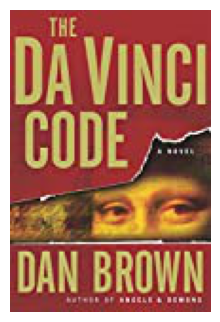

Такие рекомендации


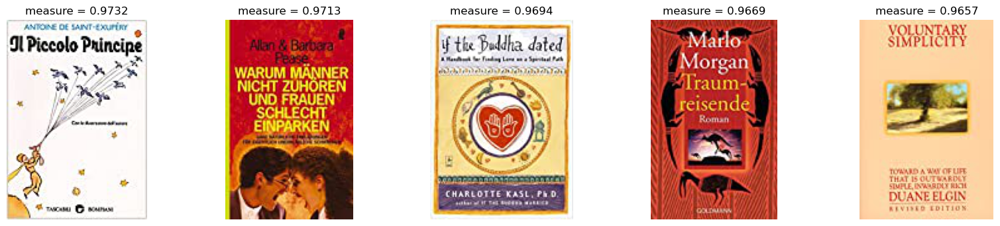

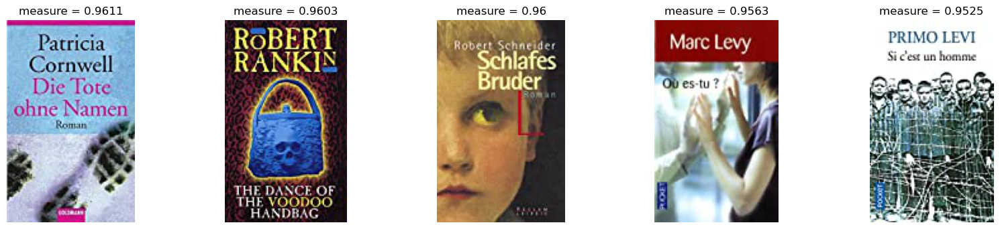

In [ ]:
mf.get_rec_I2I(3461)

## Коллаборативная фильрация

In [ ]:
class ColloborativeFiltering():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        weighted = interactions[["vid", "product_id", "picture_url", "Book-Rating"]]
        self.csr_rates = coo_matrix((weighted["Book-Rating"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))

    def get_rec_U2I(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def get_rec_I2I(self, idx):
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [ ]:
cf = ColloborativeFiltering(interactions)

Для таких товаров


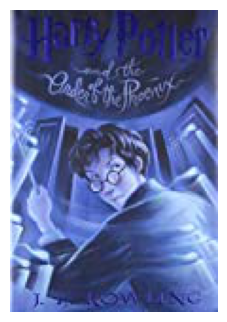

Такие рекомендации


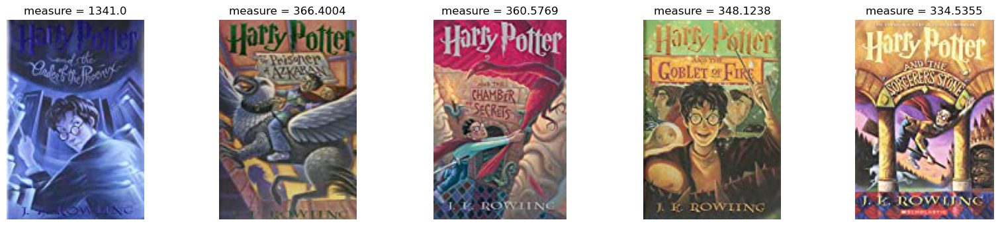

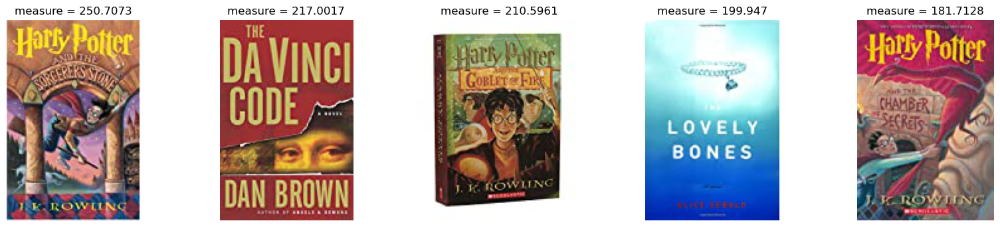

In [ ]:
cf.get_rec_I2I(4233)

Для таких товаров


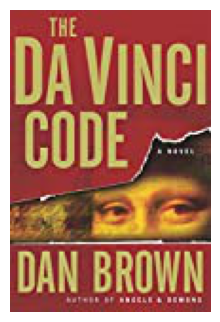

Такие рекомендации


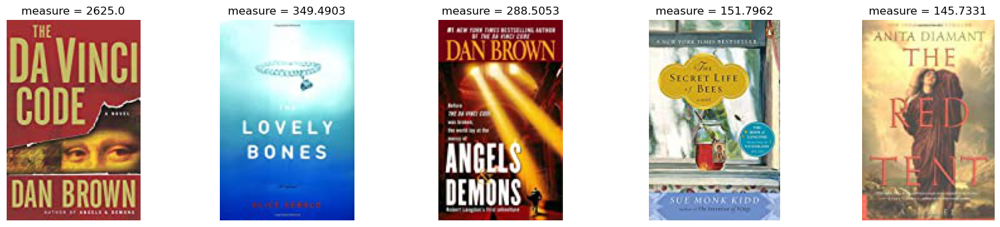

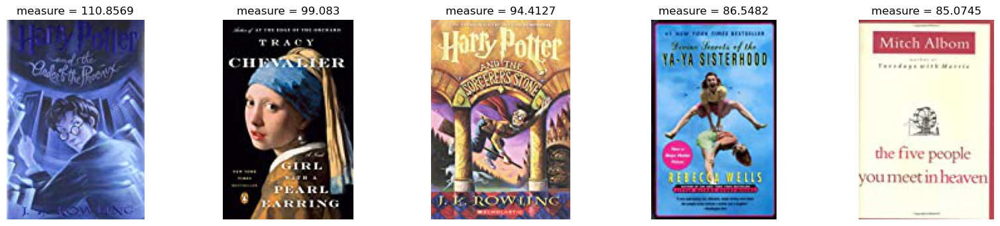

In [ ]:
cf.get_rec_I2I(3461)

Для таких товаров


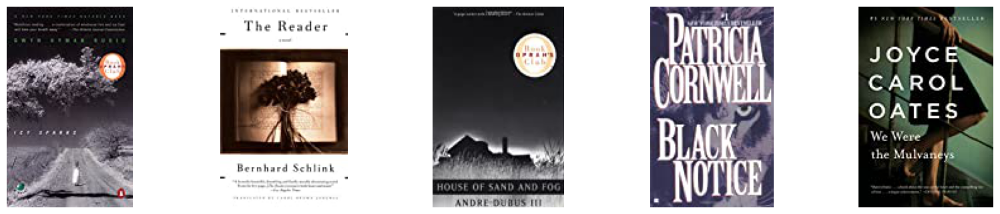

Такие рекомендации


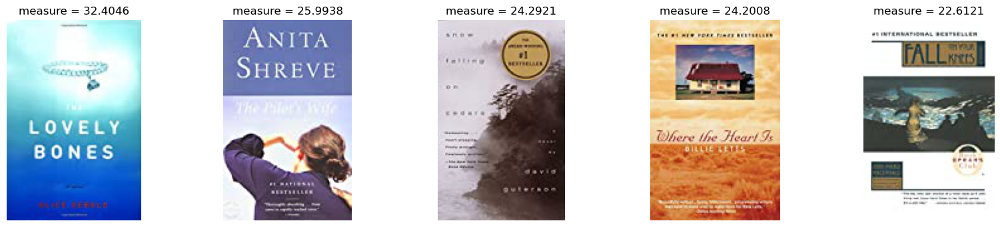

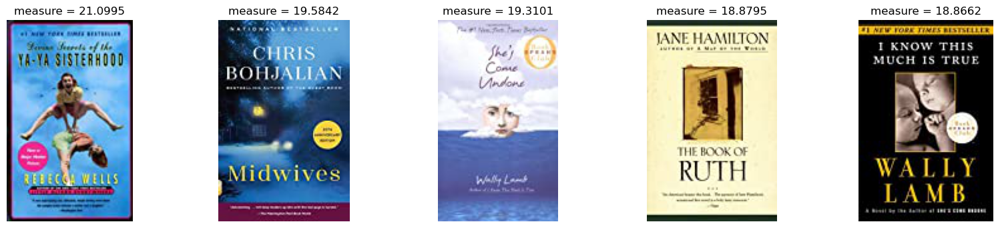

In [ ]:
cf.get_rec_U2I(1000)